In [173]:
import numpy as np
import cv2
from matplotlib import pyplot as plt
import math
import scipy.ndimage as nd

In [166]:
match = cv2.imread('../../ImagenesRansac/macheo1.png')
match_gray = cv2.cvtColor(match,cv2.COLOR_BGR2GRAY)

sift = cv2.xfeatures2d.SIFT_create(sigma = 0.9, contrastThreshold=0.04, edgeThreshold=1.6)



In [213]:
(kps_orig,desc_orig) = sift.detectAndCompute(match_gray, None)

img_aux = np.zeros(match_gray.shape)

In [168]:
img = cv2.drawKeypoints(match_gray, kps, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS, outImage=img_aux)

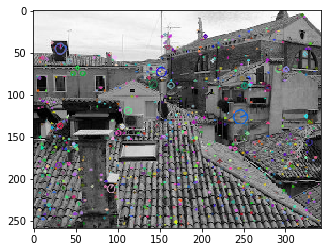

In [169]:
plt.imshow(img)#, cmap='gray')
plt.show()

In [191]:
len(kps)

974

In [174]:
rotate_images = []
for i in range(1,37):
    rot_aux = nd.rotate(match_gray, angle=i*10, reshape=True)
    rotate_images.append(rot_aux)

10


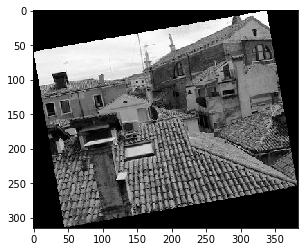

20


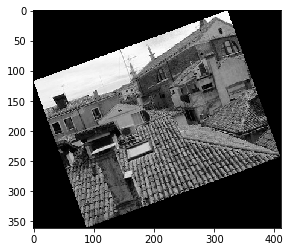

30


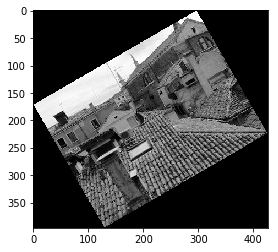

40


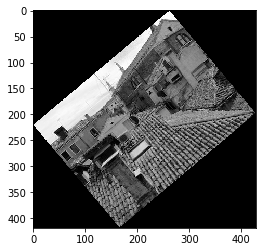

50


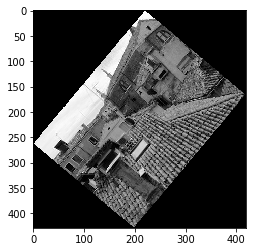

60


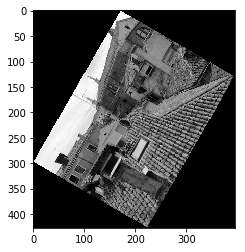

70


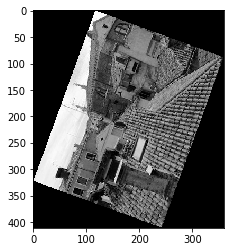

80


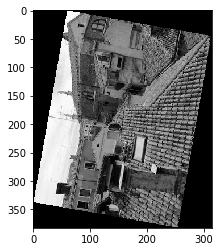

90


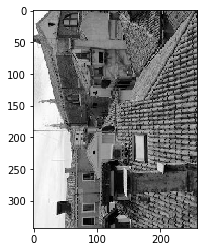

100


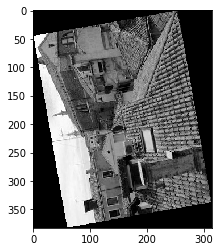

110


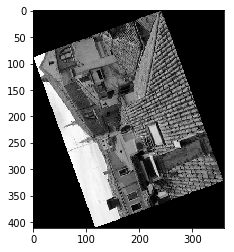

120


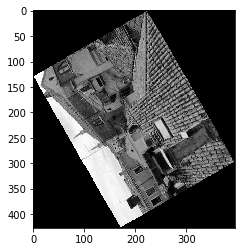

130


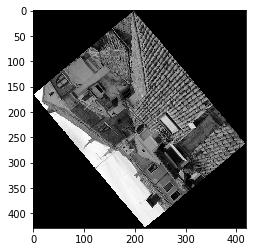

140


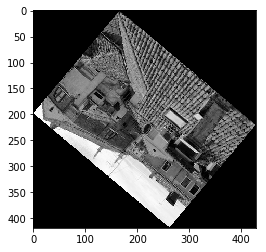

150


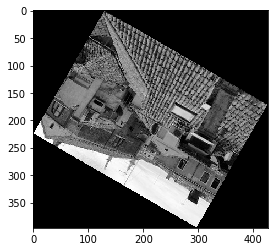

160


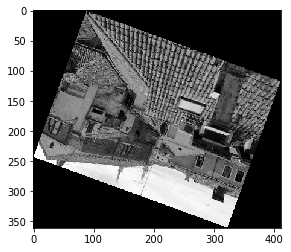

170


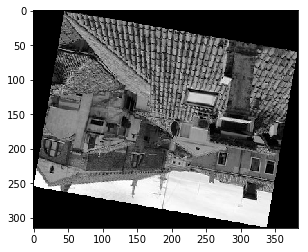

180


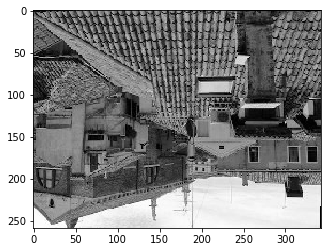

190


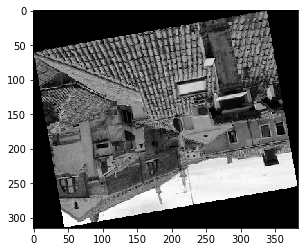

200


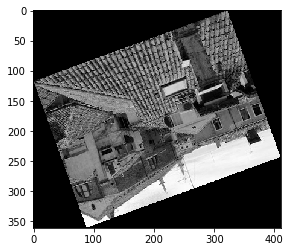

210


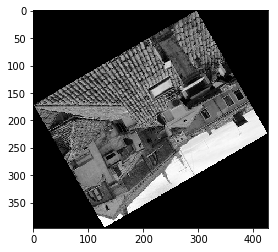

220


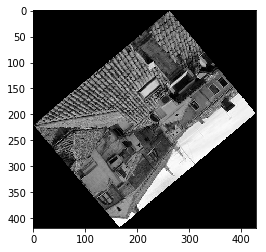

230


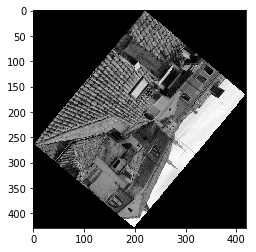

240


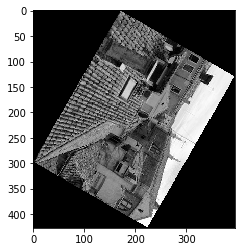

250


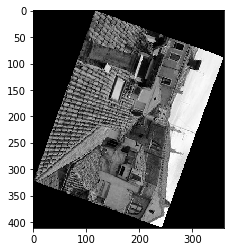

260


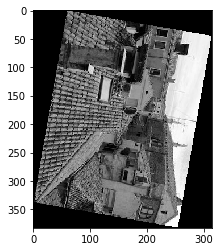

270


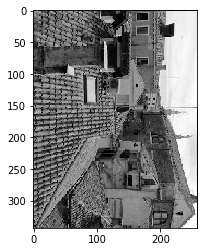

280


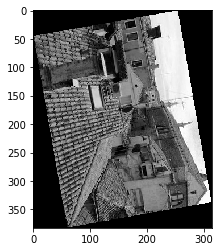

290


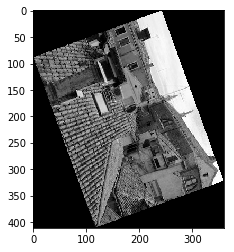

300


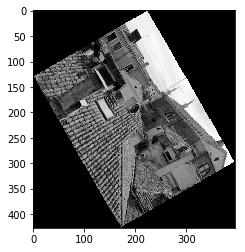

310


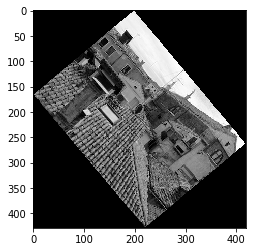

320


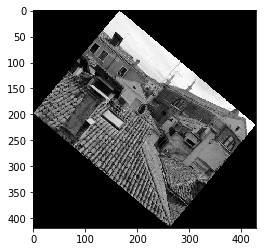

330


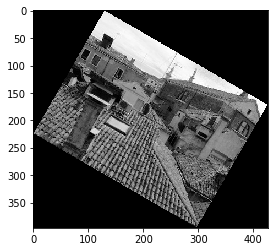

340


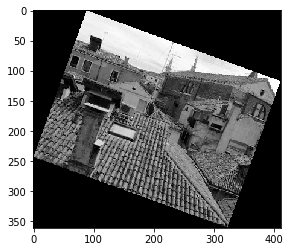

350


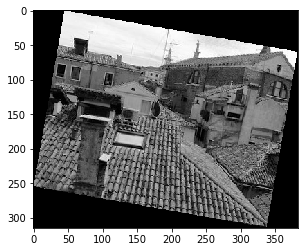

360


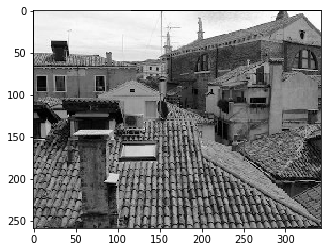

In [177]:
i = 10
for img in rotate_images:
    print(i)
    i += 10
    plt.imshow(img, cmap='gray')
    plt.show()

In [188]:
size = match_gray.shape
scale_images = []
for i in range(2, 21):
    scale = i/10
    tup = (math.floor(size[1]*scale), math.floor(size[0]*scale))
    scale_aux = cv2.resize(match_gray, dsize=tup, interpolation=cv2.INTER_CUBIC)
    scale_images.append(scale_aux)

0.2


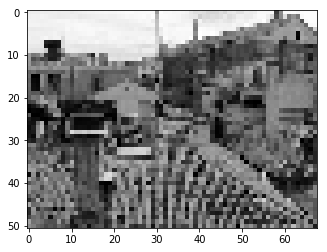

0.30000000000000004


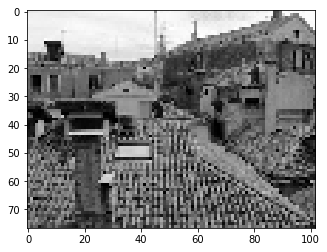

0.4


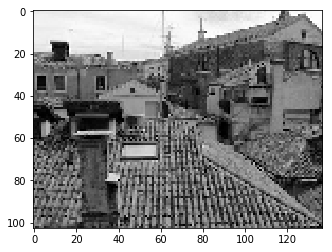

0.5


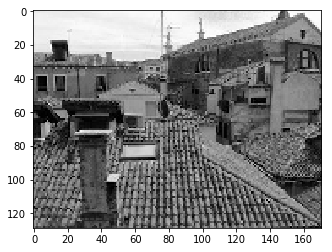

0.6


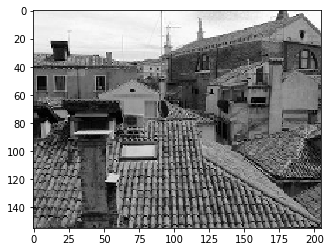

0.7


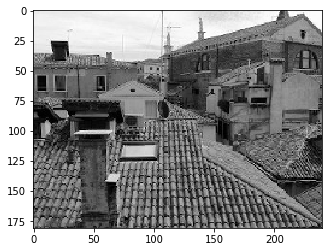

0.7999999999999999


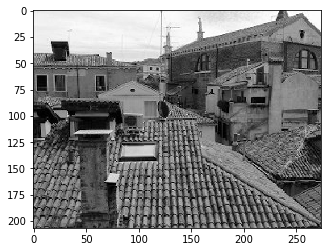

0.8999999999999999


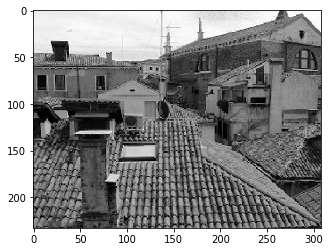

0.9999999999999999


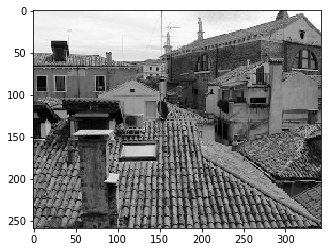

1.0999999999999999


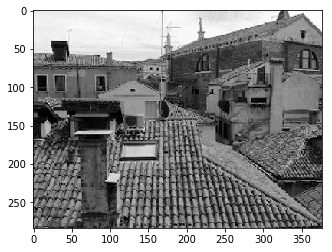

1.2


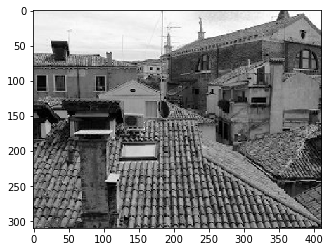

1.3


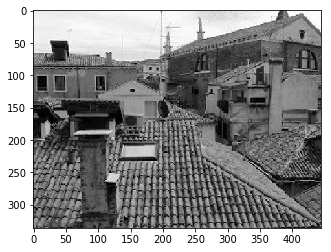

1.4000000000000001


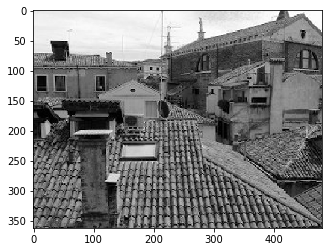

1.5000000000000002


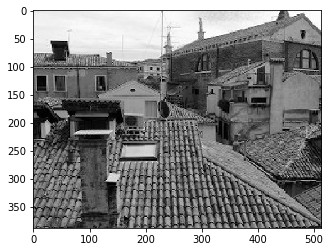

1.6000000000000003


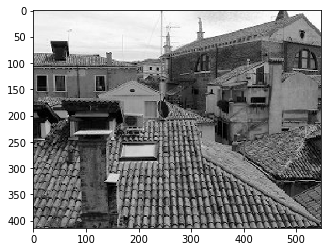

1.7000000000000004


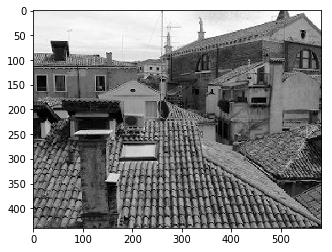

1.8000000000000005


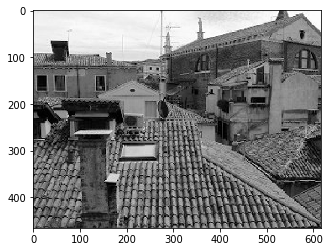

1.9000000000000006


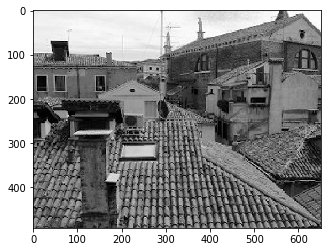

2.0000000000000004


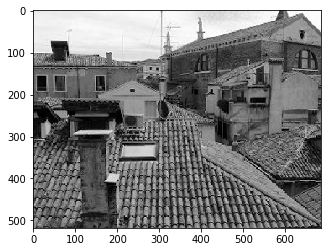

In [189]:
i = 0.2
for img in scale_images:
    print(i)
    i += 0.1
    plt.imshow(img, cmap='gray')
    plt.show()

In [199]:
brightness_images = []
for i in range(-127, 128,10):
    aux = np.copy(match_gray)
    aux = aux + np.ones(size)*i
    aux[aux>255] = 255
    aux[aux<0] = 0
    aux = aux.astype(np.uint8)
    brightness_images.append(aux)

[[233 230 230 232 236 233 235 236 236 236]
 [230 228 230 232 235 229 230 233 233 233]
 [233 232 235 236 238 232 232 236 236 236]
 [233 232 234 234 236 231 233 236 236 236]
 [237 237 238 237 240 236 239 240 240 240]
 [239 240 239 237 240 238 241 240 240 241]
 [239 240 239 237 240 238 241 240 240 241]
 [239 240 239 237 241 238 241 241 241 241]
 [239 240 240 238 241 238 241 241 241 241]
 [238 240 240 238 242 239 241 241 241 241]]
--------
[[106 103 103 105 109 106 108 109 109 109]
 [103 101 103 105 108 102 103 106 106 106]
 [106 105 108 109 111 105 105 109 109 109]
 [106 105 107 107 109 104 106 109 109 109]
 [110 110 111 110 113 109 112 113 113 113]
 [112 113 112 110 113 111 114 113 113 114]
 [112 113 112 110 113 111 114 113 113 114]
 [112 113 112 110 114 111 114 114 114 114]
 [112 113 113 111 114 111 114 114 114 114]
 [111 113 113 111 115 112 114 114 114 114]]
[[233 230 230 232 236 233 235 236 236 236]
 [230 228 230 232 235 229 230 233 233 233]
 [233 232 235 236 238 232 232 236 236 236]


-127


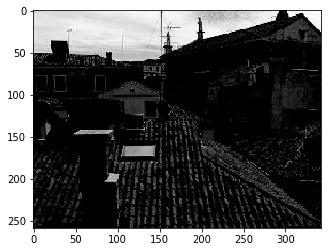

-117


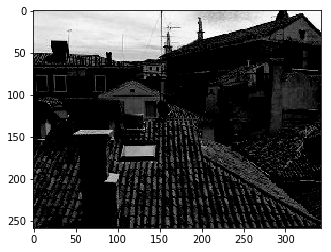

-107


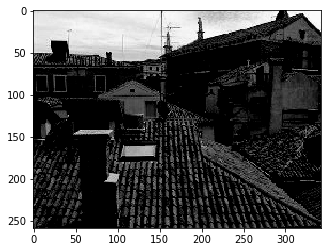

-97


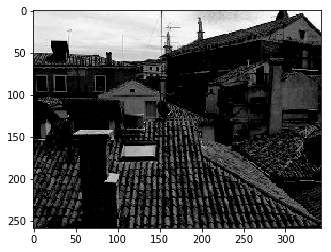

-87


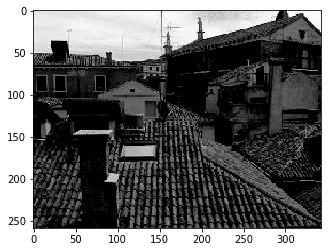

-77


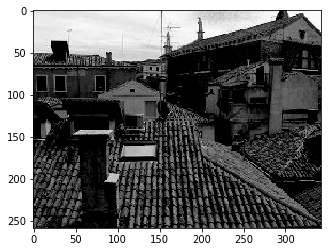

-67


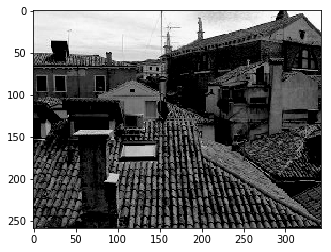

-57


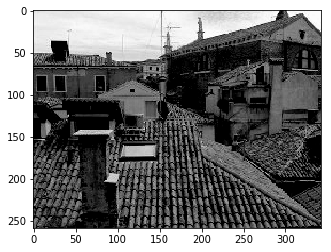

-47


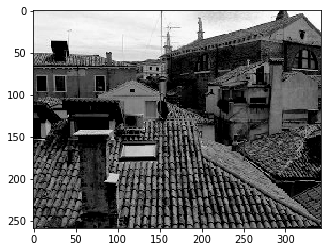

-37


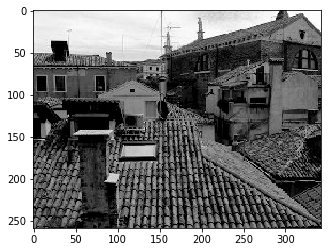

-27


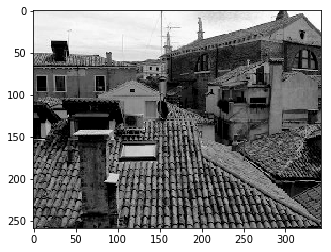

-17


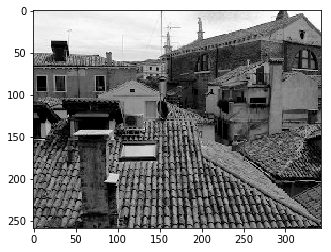

-7


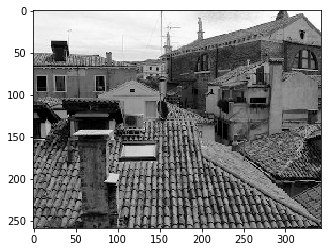

3


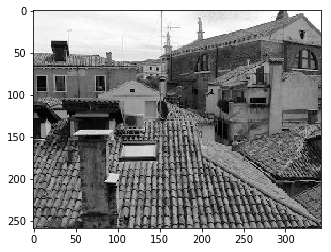

13


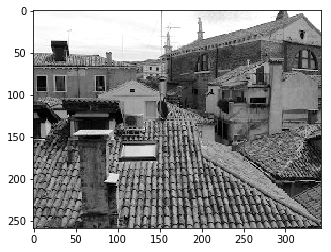

23


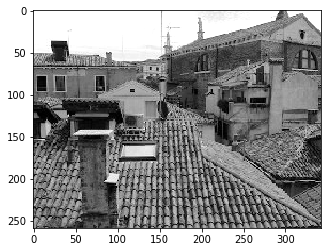

33


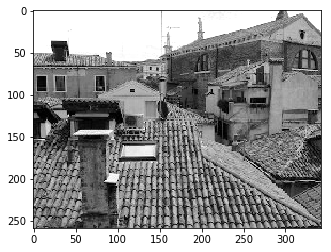

43


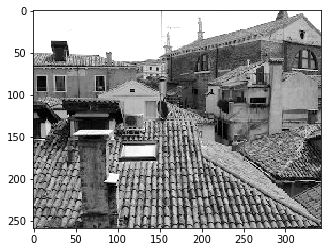

53


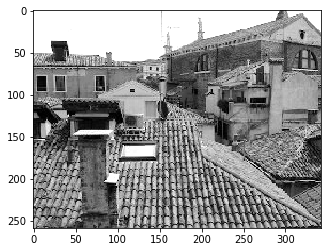

63


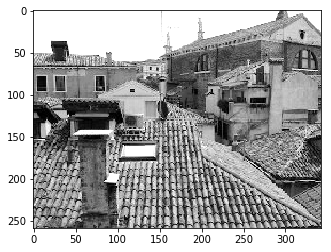

73


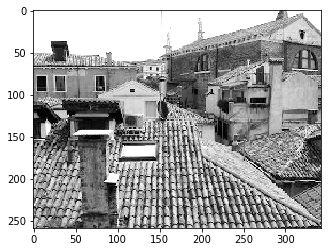

83


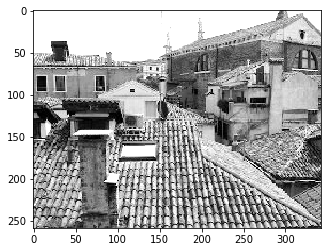

93


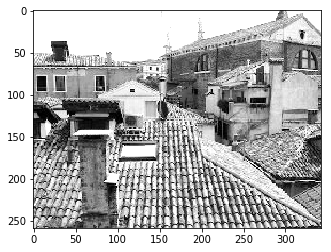

103


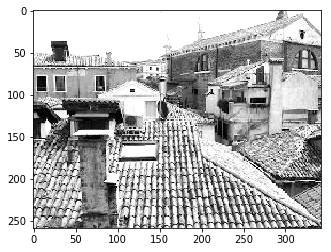

113


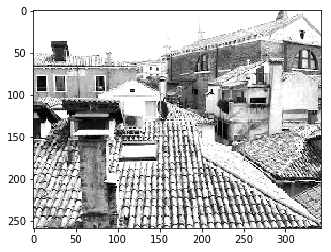

123


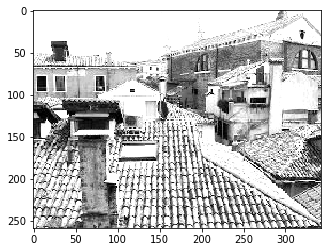

In [200]:
i = -127
for img in brightness_images:
    print(i)
    i += 10
    plt.imshow(img, cmap='gray')
    plt.show()

In [201]:
gauss_matrix = np.zeros(match_gray.shape)

In [202]:
noise_images = []
for sigma in range(3,42,2):
    aux = np.copy(match_gray)
    cv2.randn(gauss_matrix, 0, sigma)
    aux = aux + gauss_matrix
    aux[aux>255] = 255
    aux[aux<0] = 0
    aux = aux.astype(np.uint8)
    noise_images.append(aux)

3


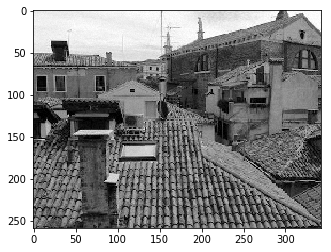

5


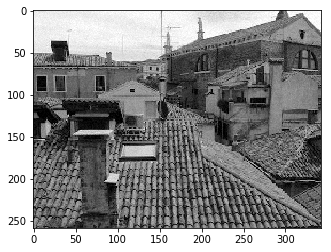

7


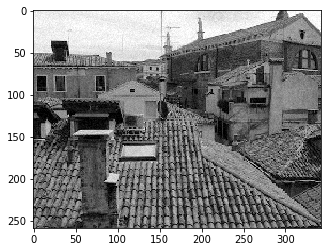

9


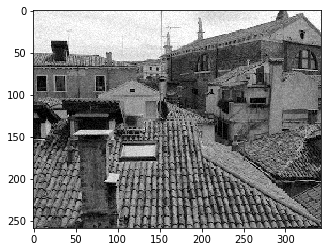

11


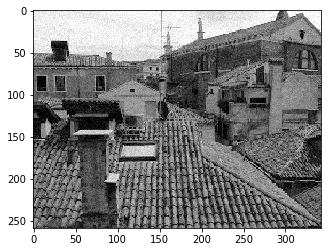

13


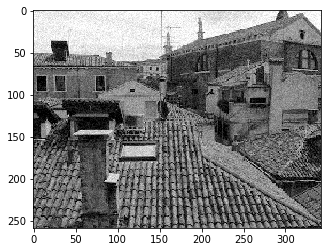

15


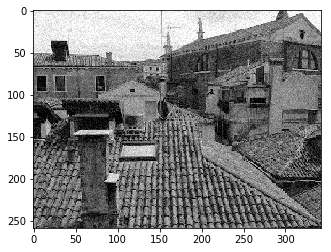

17


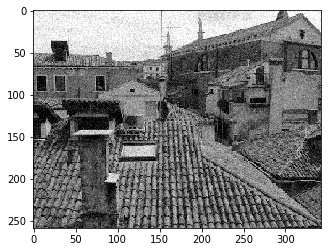

19


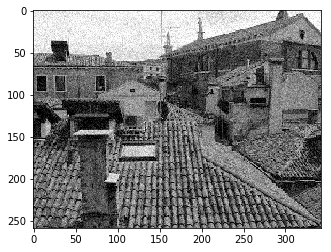

21


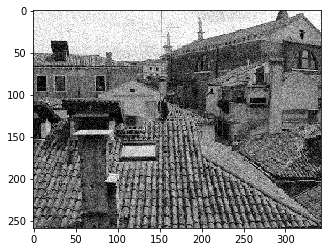

23


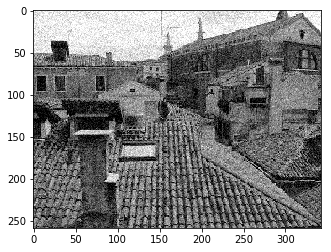

25


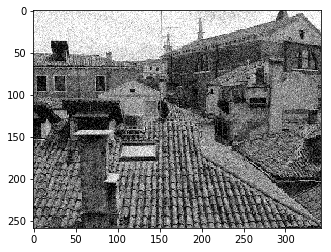

27


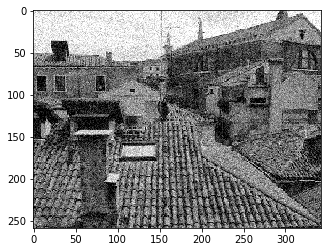

29


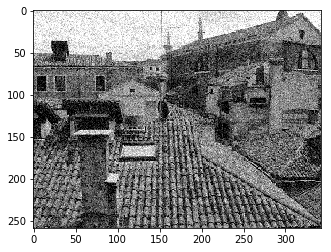

31


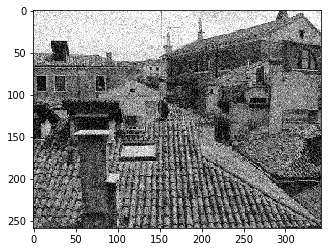

33


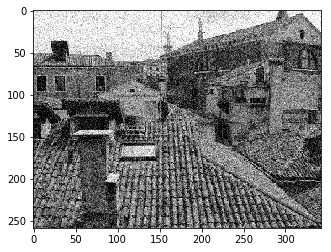

35


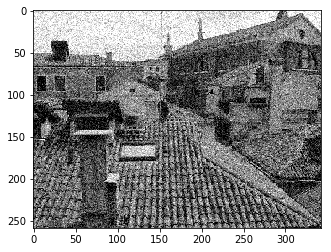

37


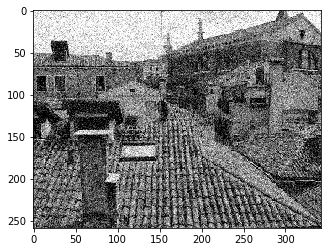

39


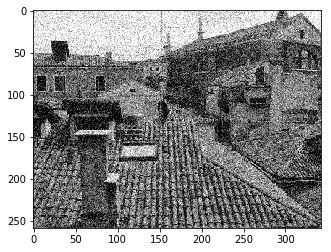

41


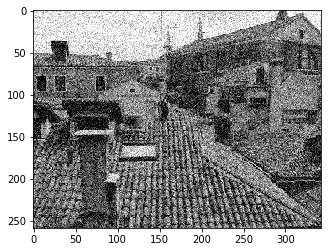

In [205]:
i = 3
for img in noise_images:
    print(i)
    i += 2
    plt.imshow(img, cmap='gray')
    plt.show()

In [208]:
print(len(noise_images)+len(brightness_images)+len(scale_images)+len(rotate_images))
print(len(noise_images),len(brightness_images),len(scale_images),len(rotate_images))

101
20 26 19 36


In [210]:
all_images = noise_images + brightness_images + scale_images + rotate_images

In [216]:
keypoints = []
for image in all_images:
    (kps,desc) = sift.detectAndCompute(image, None)
    keypoints.append((kps,desc, image))

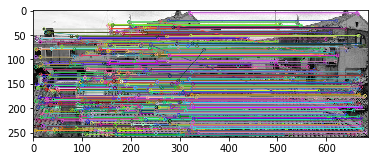

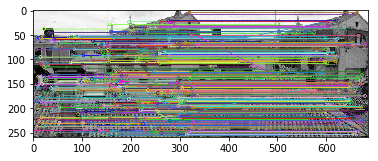

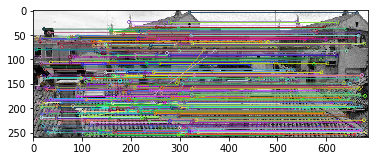

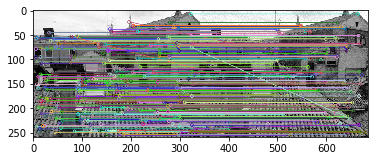

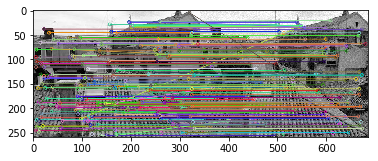

...

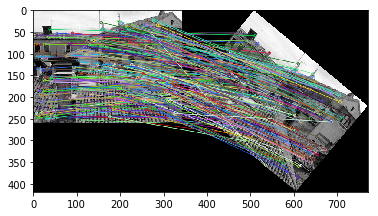

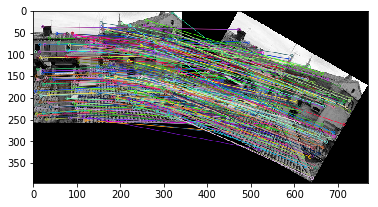

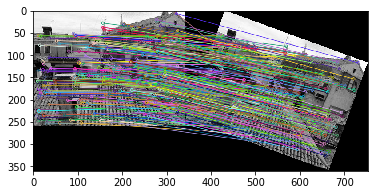

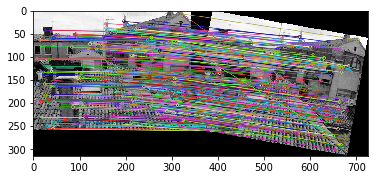

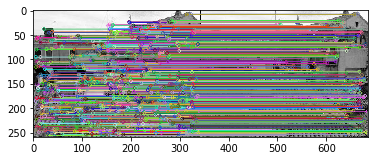

In [218]:
bf = cv2.BFMatcher()

for keys, descs, img in keypoints:
    matches = bf.knnMatch(desc_orig,descs, k=2)
    #(kps_orig,desc_orig)
    # Apply ratio test
    good = []
    for m,n in matches:
        if m.distance < 0.75*n.distance:
            good.append([m])
    img_aux = np.zeros(match_gray.shape)
    # cv2.drawMatchesKnn expects list of lists as matches.
    img3 = cv2.drawMatchesKnn(match_gray,kps_orig,img,keys,good,flags=2, outImg=img_aux)
    
    plt.imshow(img3),plt.show()
    
    
